In [ ]:
import torch
import torchvision
from torchvision import transforms
import cv2
import numpy as np

# Load pre-trained SSD model from torchvision
model = torchvision.models.detection.ssdlite320_mobilenet_v3_large(pretrained=True)
model.eval()

# COCO class labels
COCO_LABELS = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A',
    'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Transform
transform = transforms.Compose([
    transforms.ToTensor()
])

# Video input and output
cap = cv2.VideoCapture('/content/exp 5 (1).mp4')
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('ssd_output.mp4', fourcc, fps, (width, height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to tensor
    input_tensor = transform(frame).unsqueeze(0)

    # Detect
    with torch.no_grad():
        detections = model(input_tensor)[0]

    # Draw boxes
    for i in range(len(detections['boxes'])):
        score = detections['scores'][i].item()
        if score > 0.5:
            box = detections['boxes'][i].numpy().astype(int)
            label = COCO_LABELS[detections['labels'][i]]
            cv2.rectangle(frame, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
            cv2.putText(frame, f'{label}: {score:.2f}', (box[0], box[1]-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    out.write(frame)



cap.release()
out.release()
from IPython.display import HTML
from base64 import b64encode

# Display the saved video in notebook
mp4 = open('ssd_output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=640 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")

In [ ]:
import torch
import torchvision
from torchvision import transforms
import cv2
import numpy as np

# Load pre-trained SSD model from torchvision
model = torchvision.models.detection.ssdlite320_mobilenet_v3_large(pretrained=True)
model.eval()

# COCO class labels
COCO_LABELS = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A',
    'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# Transform
transform = transforms.Compose([
    transforms.ToTensor()
])

# Video input and output
cap = cv2.VideoCapture('/content/exp 5 (1).mp4')
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('ssd_output.mp4', fourcc, fps, (width, height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to tensor
    input_tensor = transform(frame).unsqueeze(0)

    # Detect
    with torch.no_grad():
        detections = model(input_tensor)[0]

    # Draw boxes
    for i in range(len(detections['boxes'])):
        score = detections['scores'][i].item()
        if score > 0.5:
            box = detections['boxes'][i].numpy().astype(int)
            label = COCO_LABELS[detections['labels'][i]]
            cv2.rectangle(frame, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 2)
            cv2.putText(frame, f'{label}: {score:.2f}', (box[0], box[1]-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    out.write(frame)



cap.release()
out.release()
from IPython.display import HTML
from base64 import b64encode

from IPython.display import HTML
from base64 import b64encode

mp4 = open('ssd_output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 height=480 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")



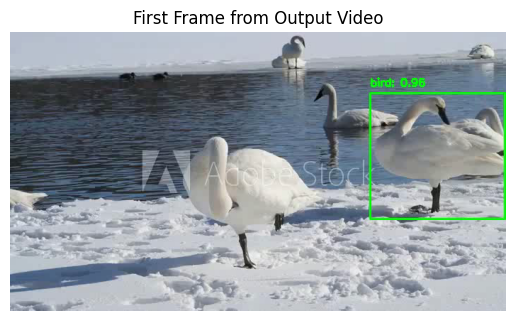

In [ ]:
import cv2
from matplotlib import pyplot as plt

cap = cv2.VideoCapture('ssd_output.mp4')
ret, frame = cap.read()
cap.release()

if ret:
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.imshow(frame)
    plt.axis('off')
    plt.title("First Frame from Output Video")
    plt.show()
else:
    print("Could not read from the video file.")


In [ ]:
import os

print("File exists:", os.path.exists("ssd_output.mp4"))
print("File size (bytes):", os.path.getsize("ssd_output.mp4") if os.path.exists("ssd_output.mp4") else 0)


File exists: True
File size (bytes): 8691136


In [ ]:
!ls "/content/exp 5 (1).mp4"


'/content/exp 5 (1).mp4'
